<a href="https://colab.research.google.com/github/Aish47/Stereo_Vision/blob/main/SpeedBumpDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


Clone YOLOv5 Repo

In [2]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 14601, done.
remote: Counting objects: 100% (155/155), done.
remote: Compressing objects: 100% (103/103), done.
remote: Total 14601 (delta 95), reused 101 (delta 52), pack-reused 14446
Receiving objects: 100% (14601/14601), 13.56 MiB | 20.45 MiB/s, done.
Resolving deltas: 100% (10066/10066), done.


Load the custom Dataset

In [18]:
%cd /content/

/content


In [ ]:
!unzip AllMerged.zip

In [21]:
%cd yolov5

/content/yolov5


Training the model

In [ ]:
!pip install wandb

In [22]:
!python train.py --img 416 --batch 22 --epochs 150 --data /content/AllMerged/data.yaml --weights /models/yolov5s.pt --single-cls --cache

wandb: Currently logged in as: aish47. Use `wandb login --relogin` to force relogin
train: weights=/models/yolov5s.pt, cfg=, data=/content/AllMerged/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=22, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=True, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-228-g6ae3dff Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5,

Validation

In [23]:
!python val.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --data /content/AllMerged/data.yaml --img 416 --half --verbose --single-cls

val: data=/content/AllMerged/data.yaml, weights=['/content/yolov5/runs/train/exp3/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=True, augment=False, verbose=True, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v6.2-228-g6ae3dff Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning '/content/AllMerged/valid/labels.cache' images and labels... 291 found, 0 missing, 0 empty, 0 corrupt: 100% 291/291 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 10/10 [00:04<00:00,  2.25it/s]
                   all        291        304      0.972      0.901      0.963      0.651
Speed: 0.4ms pre-process, 2.6ms inference, 1.5ms NMS per image at shape (32,

Testing

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --img 416 --conf 0.4 --source '/content/AllMerged/valid/images'


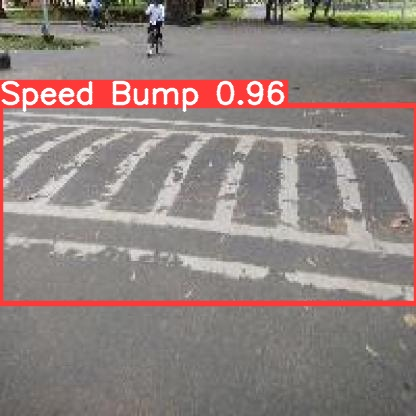

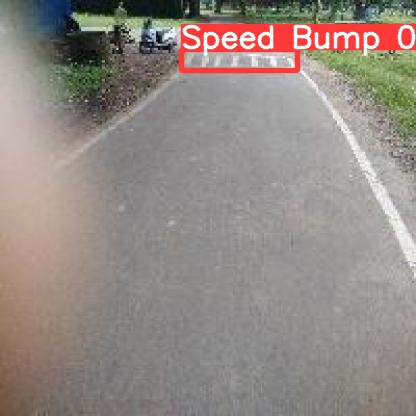

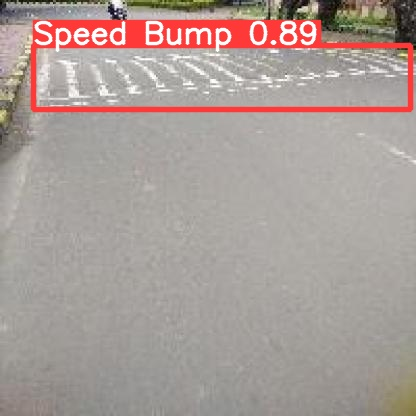

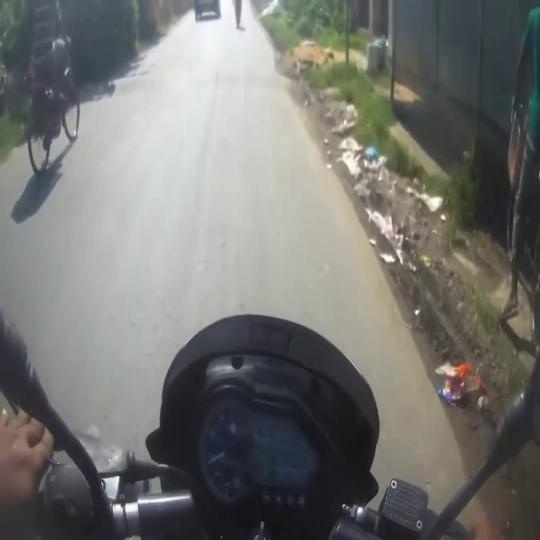

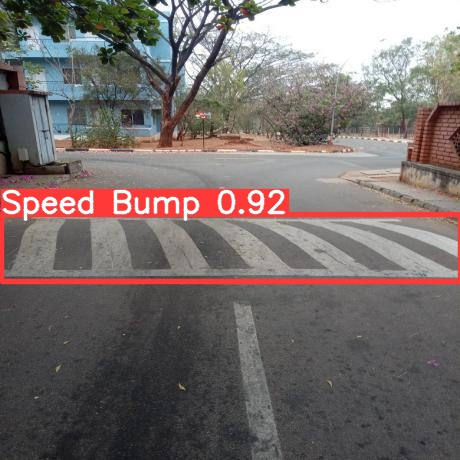

...

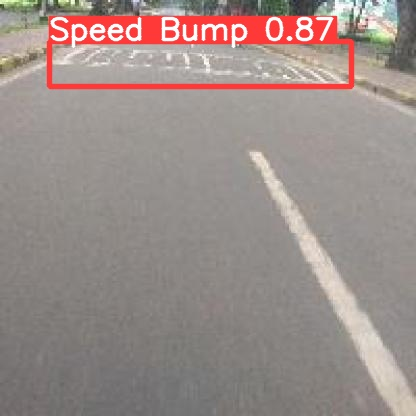

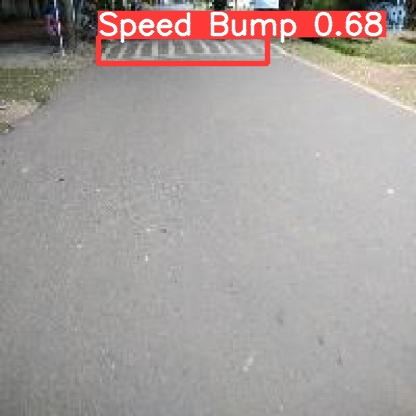

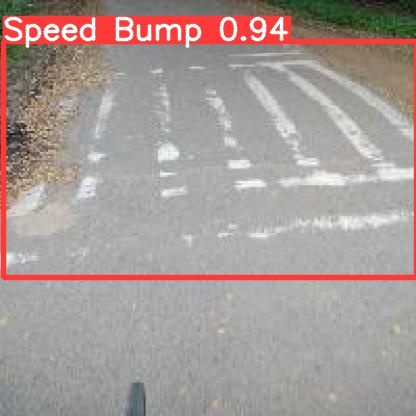

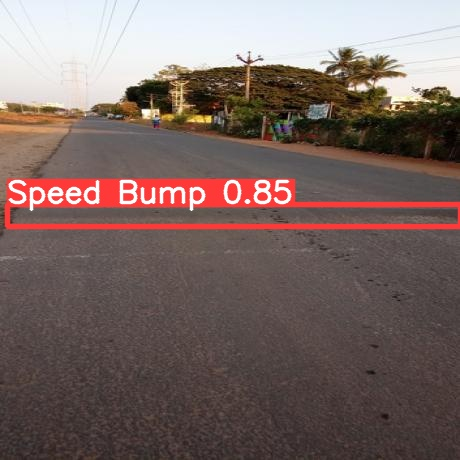

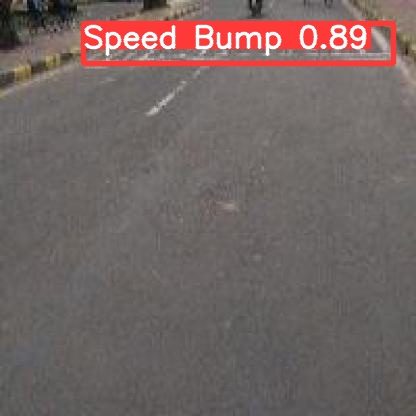

In [25]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")


In [27]:
!zip -r /content/yolov5.zip /content/yolov5 

  adding: content/yolov5/ (stored 0%)
  adding: content/yolov5/tutorial.ipynb (deflated 78%)
  adding: content/yolov5/.pre-commit-config.yaml (deflated 60%)
  adding: content/yolov5/classify/ (stored 0%)
  adding: content/yolov5/classify/predict.py (deflated 68%)
  adding: content/yolov5/classify/train.py (deflated 66%)
  adding: content/yolov5/classify/val.py (deflated 66%)
  adding: content/yolov5/setup.cfg (deflated 44%)
  adding: content/yolov5/__pycache__/ (stored 0%)
  adding: content/yolov5/__pycache__/export.cpython-37.pyc (deflated 51%)
  adding: content/yolov5/__pycache__/val.cpython-37.pyc (deflated 43%)
  adding: content/yolov5/.gitattributes (deflated 4%)
  adding: content/yolov5/benchmarks.py (deflated 68%)
  adding: content/yolov5/utils/ (stored 0%)
  adding: content/yolov5/utils/triton.py (deflated 67%)
  adding: content/yolov5/utils/metrics.py (deflated 66%)
  adding: content/yolov5/utils/autoanchor.py (deflated 60%)
  adding: content/yolov5/utils/__pycache__/ (stored 